In [1]:
# Basic Libraries
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt # we only need pyplot
sb.set() # set the default Seaborn style for graphics

In [2]:
combined_annual_data = pd.read_excel("Combined All Data.xlsx", usecols=lambda x: 'Unnamed' not in x)
combined_changed_data_together_overall = pd.read_excel("Combined Change Data.xlsx", usecols=lambda x: 'Unnamed' not in x)
combined_changed_data_together_overall_percent = pd.read_excel("Combined % Change Data.xlsx", usecols=lambda x: 'Unnamed' not in x)

In [26]:
annual_live_birth = combined_annual_data.iloc[:, :2]
annual_live_birth

,Year,number of live_birth in the year
0,1960-01-01,61775
1,1961-01-01,59930
2,1962-01-01,58977
3,1963-01-01,59530
4,1964-01-01,58217
...,...,...
58,2018-01-01,39039
59,2019-01-01,39279
60,2020-01-01,38590
61,2021-01-01,38672


In [27]:
live_birth_annual_change = pd.DataFrame(columns=["Year_Month", "Change in Live Birth"])
for i in range(1, annual_live_birth.shape[0]):
    if ((annual_live_birth.iloc[i, 1] - annual_live_birth.iloc[i-1, 1]) > 0):
        change = "INCREASE"
    else:
        change = "DECREASE"
    live_birth_annual_change.loc[i] = [annual_live_birth.iloc[i, 0], change]   
live_birth_annual_change

,Year_Month,Change in Live Birth
1,1961-01-01,DECREASE
2,1962-01-01,DECREASE
3,1963-01-01,INCREASE
4,1964-01-01,DECREASE
5,1965-01-01,DECREASE
...,...,...
58,2018-01-01,DECREASE
59,2019-01-01,INCREASE
60,2020-01-01,DECREASE
61,2021-01-01,INCREASE


## KNN (Raw Data)

In [35]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn import metrics

In [40]:
import warnings
warnings.filterwarnings("ignore")

In [54]:
combined_annual_data_temp = combined_annual_data.iloc[1:,:].copy()
combined_annual_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

sb.pairplot(combined_annual_data_temp, hue="Change in Live Birth", height=3);
plt.show()

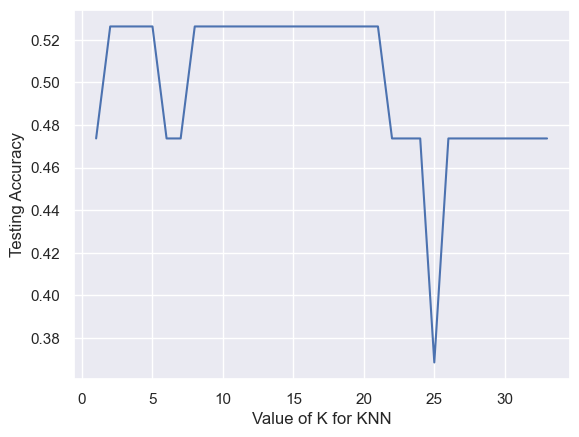

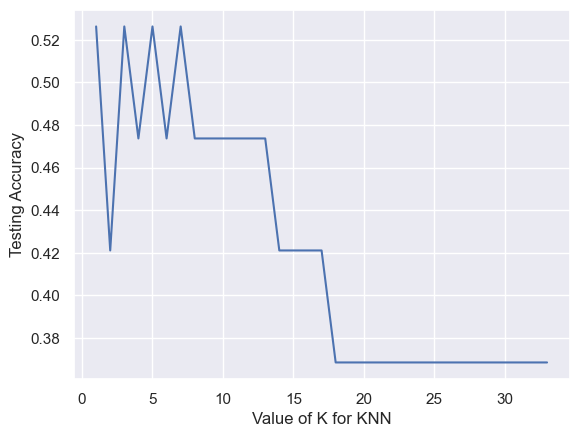

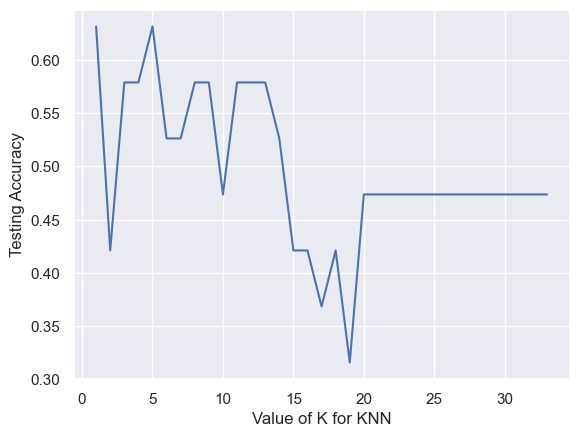

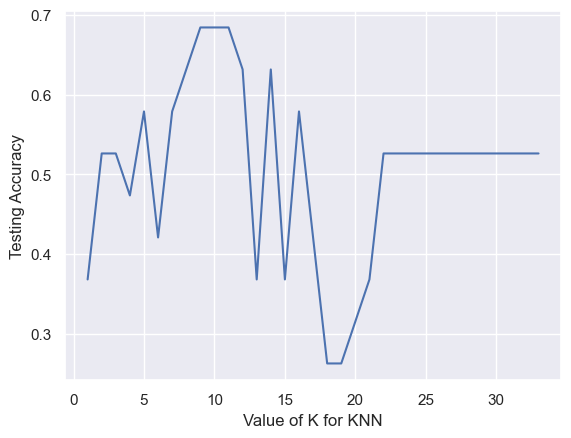

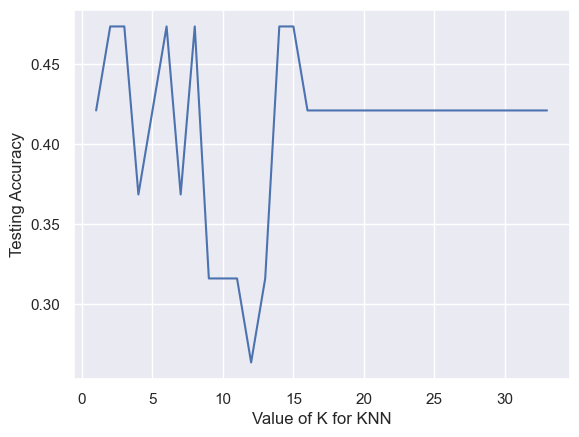

In [41]:
combined_annual_data_temp = combined_annual_data.iloc[1:,:].copy()
combined_annual_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

temp_X = combined_annual_data_temp.copy()
temp_X.fillna(temp_X.mean(), inplace=True)
temp_X

y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "number of live_birth in the year", 'Change in Live Birth'], axis = 1))

k_range = range(1, X.shape[1]+1)

for i in range(5):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)
    scores = {}
    scores_list = []
    for k in k_range:
        knn = KNeighborsClassifier(n_neighbors = k)
        knn.fit(X_train, y_train)
        y_pred = knn.predict(X_test)
        scores[k] = metrics.accuracy_score(y_test, y_pred)
        scores_list.append(metrics.accuracy_score(y_test, y_pred))
    plt.plot(k_range, scores_list)
    plt.xlabel("Value of K for KNN")
    plt.ylabel("Testing Accuracy")
    plt.show()

## KNN after Feature Reduction (Raw Data)

Text(0, 0.5, 'Testing Accuracy')

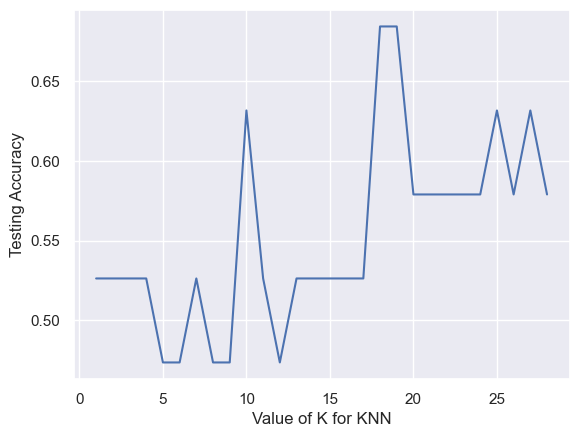

In [42]:
combined_annual_data_temp = combined_annual_data.iloc[1:,:].copy()
combined_annual_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

temp_X = combined_annual_data_temp.copy()
temp_X.fillna(temp_X.mean(), inplace=True)
temp_X

y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "number of live_birth in the year", 'Change in Live Birth'], axis = 1))

X = X.drop(X.columns[[(17-1),(18-1),(19-1), (20-1), (25-1)]], axis=1)

k_range = range(1, X.shape[1]+1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

scores = {}
scores_list = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    y_pred = knn.predict(X_test)
    scores[k] = metrics.accuracy_score(y_test, y_pred)
    scores_list.append(metrics.accuracy_score(y_test, y_pred))
plt.plot(k_range, scores_list)
plt.xlabel("Value of K for KNN")
plt.ylabel("Testing Accuracy")

## KNN (Change Data)

In [55]:
sb.pairplot(combined_changed_data_together_overall, hue="Change in Live Birth", height=3);
plt.show()

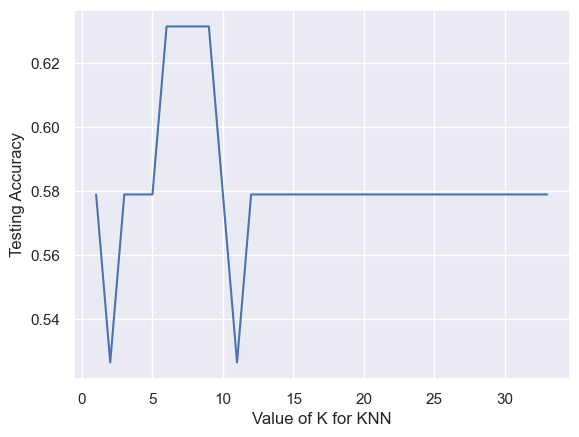

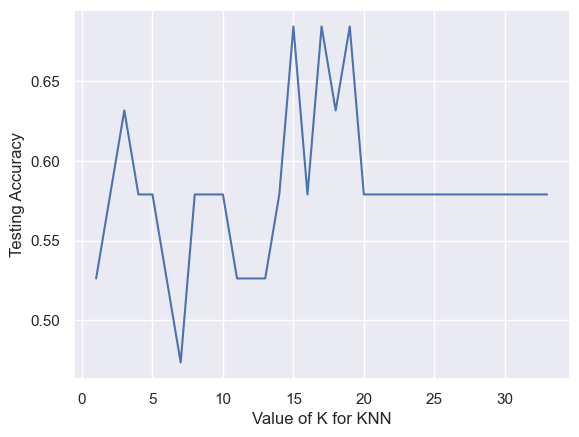

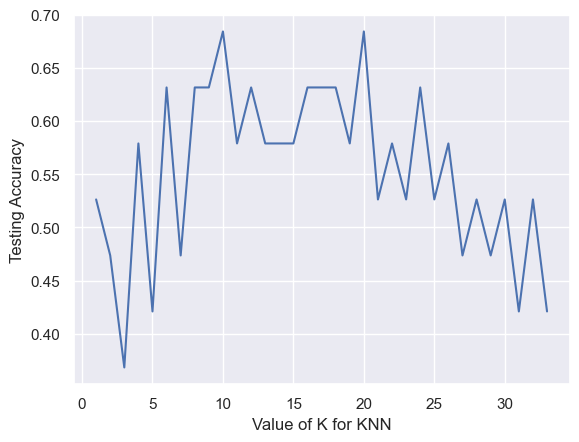

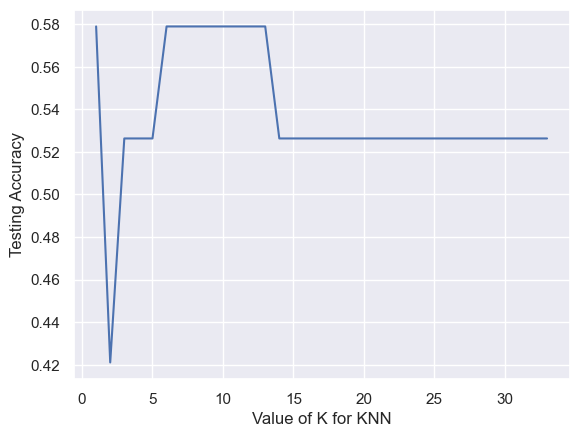

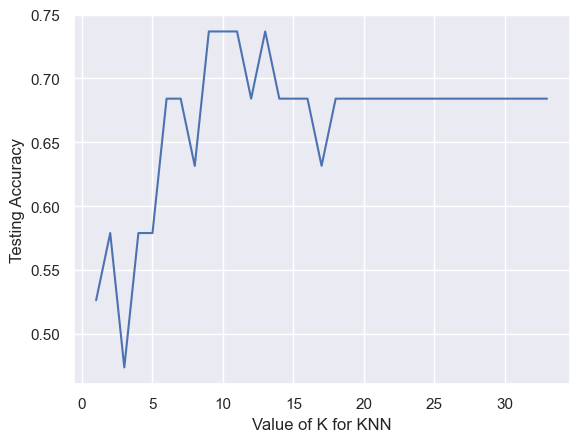

In [45]:
temp_X = combined_changed_data_together_overall.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)
temp_X.fillna(temp_X.mean(), inplace=True)

temp_X

y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

k_range = range(1, X.shape[1]+1)

for i in range(5):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)
    scores = {}
    scores_list = []
    for k in k_range:
        knn = KNeighborsClassifier(n_neighbors = k)
        knn.fit(X_train, y_train)
        y_pred = knn.predict(X_test)
        scores[k] = metrics.accuracy_score(y_test, y_pred)
        scores_list.append(metrics.accuracy_score(y_test, y_pred))
    plt.plot(k_range, scores_list)
    plt.xlabel("Value of K for KNN")
    plt.ylabel("Testing Accuracy")
    plt.show()

## KNN after Feature Reduction (Change Data)

Text(0, 0.5, 'Testing Accuracy')

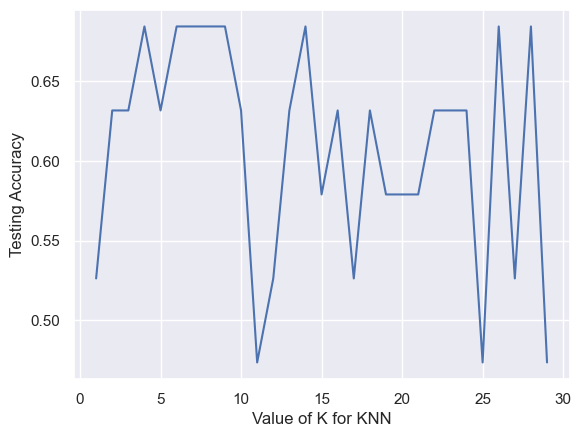

In [46]:
temp_X = combined_changed_data_together_overall.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)
temp_X.fillna(temp_X.mean(), inplace=True)

temp_X

y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

X = X.drop(X.columns[[(2-1),(3-1),(7-1), (12-1)]], axis=1)

k_range = range(1, X.shape[1]+1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

scores = {}
scores_list = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    y_pred = knn.predict(X_test)
    scores[k] = metrics.accuracy_score(y_test, y_pred)
    scores_list.append(metrics.accuracy_score(y_test, y_pred))
plt.plot(k_range, scores_list)
plt.xlabel("Value of K for KNN")
plt.ylabel("Testing Accuracy")

## KNN (% Change Data)

In [56]:
sb.pairplot(combined_changed_data_together_overall_percent, hue="Change in Live Birth", height=3);
plt.show()

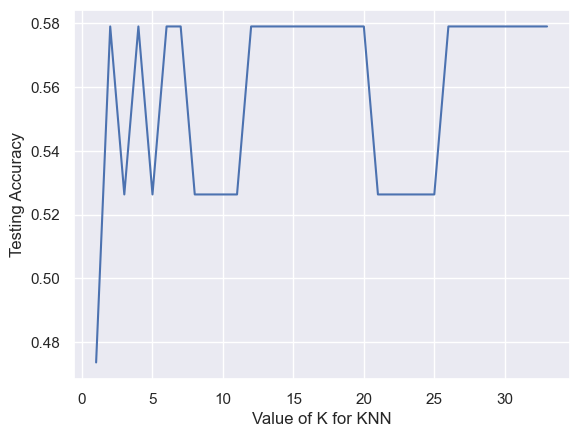

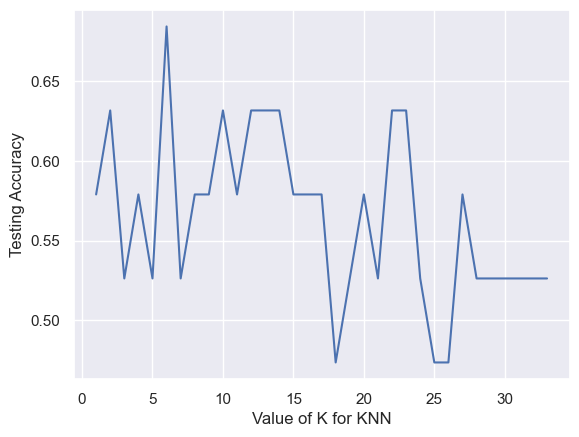

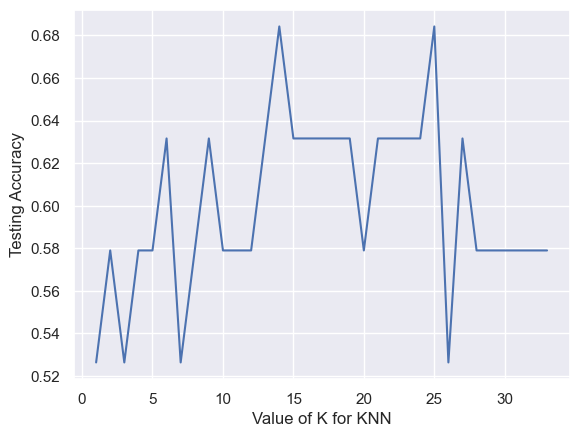

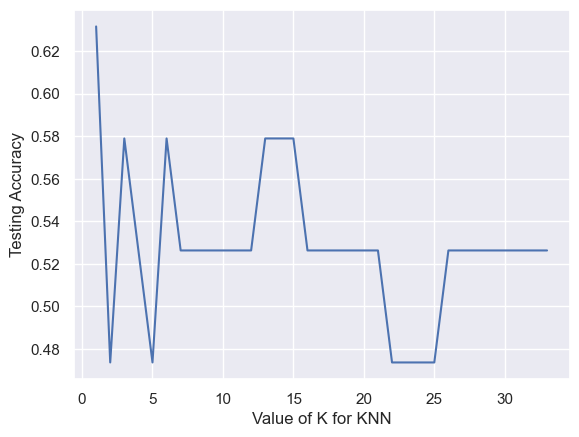

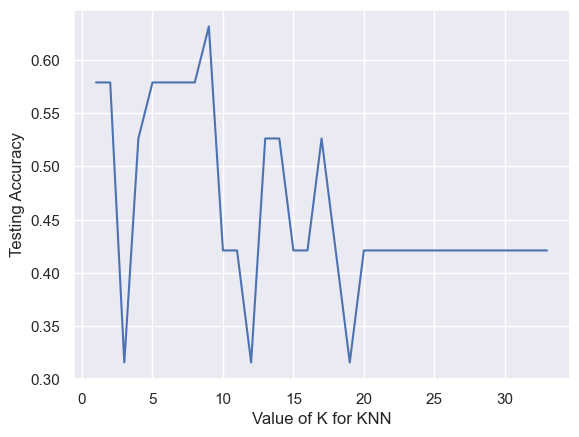

In [47]:
temp_X = combined_changed_data_together_overall_percent.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)
temp_X.fillna(temp_X.mean(), inplace=True)

temp_X

y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

k_range = range(1, X.shape[1]+1)

for i in range(5):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)
    scores = {}
    scores_list = []
    for k in k_range:
        knn = KNeighborsClassifier(n_neighbors = k)
        knn.fit(X_train, y_train)
        y_pred = knn.predict(X_test)
        scores[k] = metrics.accuracy_score(y_test, y_pred)
        scores_list.append(metrics.accuracy_score(y_test, y_pred))
    plt.plot(k_range, scores_list)
    plt.xlabel("Value of K for KNN")
    plt.ylabel("Testing Accuracy")
    plt.show()

## KNN after Feature Reduction (% Change Data)

Text(0, 0.5, 'Testing Accuracy')

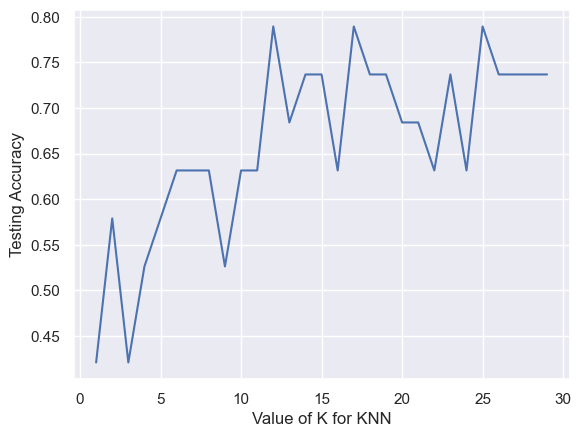

In [53]:
temp_X = combined_changed_data_together_overall_percent.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)
temp_X.fillna(temp_X.mean(), inplace=True)

temp_X

y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

X = X.drop(X.columns[[(1-1),(3-1),(25-1), (26-1)]], axis=1)

k_range = range(1, X.shape[1]+1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

scores = {}
scores_list = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    y_pred = knn.predict(X_test)
    scores[k] = metrics.accuracy_score(y_test, y_pred)
    scores_list.append(metrics.accuracy_score(y_test, y_pred))
plt.plot(k_range, scores_list)
plt.xlabel("Value of K for KNN")
plt.ylabel("Testing Accuracy")